In [1]:
import pandas  as pd
import matplotlib.pyplot as plt

In [43]:
df_vn = pd.read_csv("datasets/vn_chart.csv")
df_glob = pd.read_csv("datasets/global_chart.csv")

In [44]:
df_vn = df_vn.drop_duplicates()
df_glob = df_glob.drop_duplicates()

In [45]:
df = pd.read_csv("datasets/audio_features.csv")
df_1 = pd.read_csv("datasets/audio_features_no_in.csv")

### Số dòng, số cột

In [46]:
df_vn.shape

(64394, 9)

In [47]:
df_glob.shape

(64304, 9)

### Số ngày thu thập

In [57]:
df_vn.date.nunique()

322

### Số bài hát từng lọt top trong 2023

In [48]:
df.shape

(2105, 21)

### Số bài hát chưa từng lọt top trong 2023

In [49]:
df_1.shape

(665, 21)

### Số ngày thu thập:

In [50]:
df_vn.date.nunique()

322

### Ngày thu thập mới nhất

In [51]:
pd.to_datetime(df_vn['date']).max()

Timestamp('2023-11-18 00:00:00')

### Ngày phát hành các bài hát đạt top

In [52]:
pd.to_datetime(df['release_date']).dt.year.value_counts()

2023    1268
2022     343
2021      98
2020      90
2019      56
2017      41
2018      31
2016      29
2014      22
2013      12
2010      11
2015      11
2012      10
2011       9
2007       6
2009       5
2004       5
2000       4
2003       4
1993       3
1984       3
2002       3
1985       3
1994       2
2005       2
1979       2
1982       2
1990       2
1983       2
1977       2
1970       2
2008       2
1973       1
1999       1
1959       1
1964       1
1942       1
2006       1
1962       1
1969       1
1989       1
1991       1
1976       1
1975       1
1998       1
1981       1
1978       1
1995       1
1997       1
1980       1
1987       1
1963       1
Name: release_date, dtype: int64

In [53]:
df = df.drop(columns=['popularity','release_date','album_id','album_name','track_number','preview_url'])

df_no_in = pd.read_csv("datasets/audio_features_no_in.csv").drop(columns=['popularity','release_date','album_id','album_name','track_number','preview_url'])

### Tương quan giữa 2 thị trường nhạc:

In [54]:
vn_songs = set(df_vn["track"])
glob_songs = set(df_glob["track"])

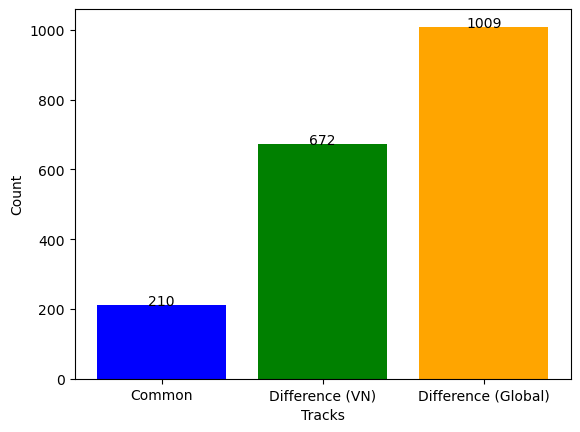

In [55]:
common_songs = len(vn_songs.intersection(glob_songs))

unique_vn_songs = len(vn_songs.difference(glob_songs))
unique_glob_songs = len(glob_songs.difference(vn_songs))

categories = ['Common', 'Difference (VN)', 'Difference (Global)']
counts = [common_songs, unique_vn_songs, unique_glob_songs]


plt.bar(categories, counts, color=['blue', 'green', 'orange'])
for i in range(len(categories)):
    plt.text(i, counts[i], str(counts[i]), ha='center')
plt.xlabel('Tracks')
plt.ylabel('Count')


plt.show()


Chia 2 thị trường riêng 

=====================================================================================================================

In [10]:
df_vn.dtypes

date        object
position     int64
id          object
track       object
artist      object
peak         int64
prev         int64
streak       int64
streams      int64
dtype: object

In [79]:
df_vn['date'] = pd.to_datetime(df_vn['date'])
df_glob['date'] = pd.to_datetime(df_glob['date'])

In [12]:
df['explicit'] = df['explicit'].astype(int)

df_no_in['explicit'] = df_no_in['explicit'].astype(int)

Phân cụm theo tháng để dự đoán được xu hướng 

Tháng 1:

In [13]:
df_vn_m = []

max_month = max(df_vn.date.dt.month)

for i in range(1,max_month+1):
    ids = set(df_vn[df_vn.date.dt.month== max_month]['id'])
    df_vn_m.append(df[df['id'].isin(ids)].copy())

In [14]:
from sklearn.manifold import TSNE
import plotly.express as px
import seaborn as sns

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [17]:
df.dtypes

id                   object
danceability        float64
energy              float64
key                   int64
loudness            float64
mode                  int64
speechiness         float64
acousticness        float64
instrumentalness    float64
liveness            float64
valence             float64
tempo               float64
duration_ms           int64
time_signature        int64
explicit              int32
dtype: object

In [18]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

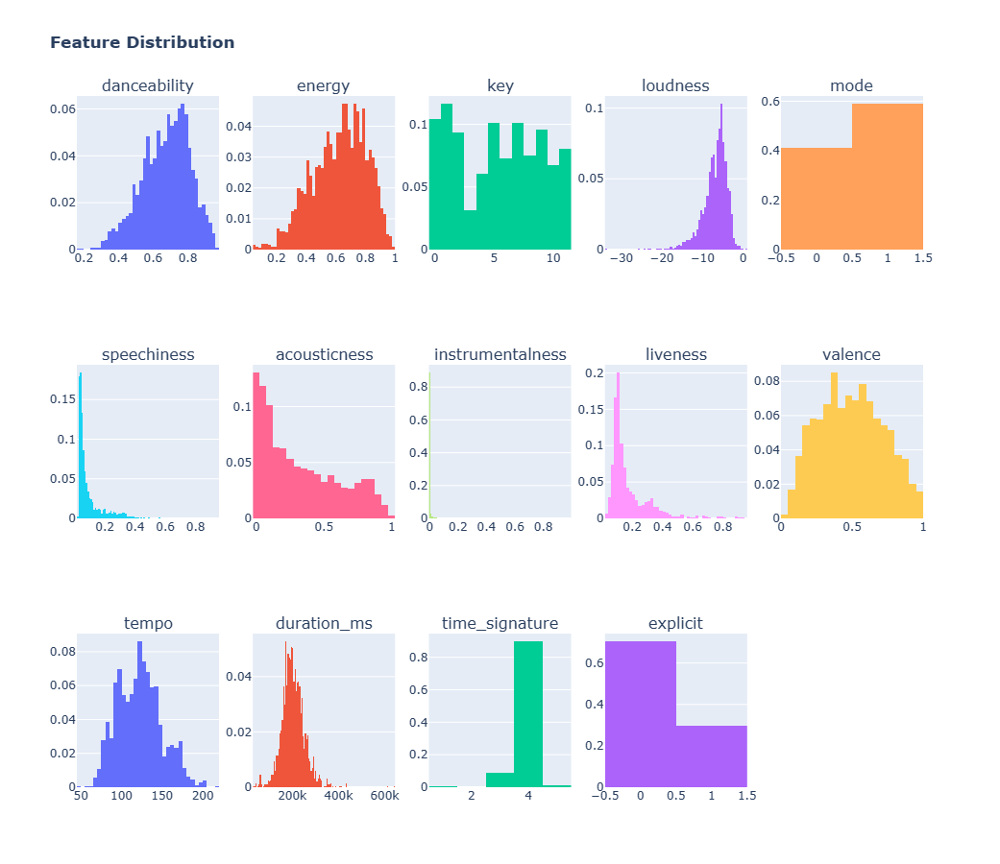

In [19]:
fig=make_subplots(rows=3,cols=5,subplot_titles=df.drop(columns='id').columns)
fig.add_trace(go.Histogram(x=df['danceability'],name='danceability',histnorm="probability"),row=1,col=1)
fig.add_trace(go.Histogram(x=df['energy'],name='energy',histnorm="probability"),row=1,col=2)
fig.add_trace(go.Histogram(x=df['key'],name='key',histnorm="probability"),row=1,col=3)
fig.add_trace(go.Histogram(x=df['loudness'],name='loudness',histnorm="probability"),row=1,col=4)
fig.add_trace(go.Histogram(x=df['mode'],name='mode',histnorm="probability"),row=1,col=5)
fig.add_trace(go.Histogram(x=df['speechiness'],name='speechiness',histnorm="probability"),row=2,col=1)
fig.add_trace(go.Histogram(x=df['acousticness'],name='acousticness',histnorm="probability"),row=2,col=2)
fig.add_trace(go.Histogram(x=df['instrumentalness'],name='instrumentalness',histnorm="probability"),row=2,col=3)
fig.add_trace(go.Histogram(x=df['liveness'],name='liveness',histnorm="probability"),row=2,col=4)
fig.add_trace(go.Histogram(x=df['valence'],name='valence',histnorm="probability"),row=2,col=5)
fig.add_trace(go.Histogram(x=df['tempo'],name='tempo',histnorm="probability"),row=3,col=1)
fig.add_trace(go.Histogram(x=df['duration_ms'],name='duration_ms',histnorm="probability"),row=3,col=2)
fig.add_trace(go.Histogram(x=df['time_signature'],name='time_signature',histnorm="probability"),row=3,col=3)
fig.add_trace(go.Histogram(x=df['explicit'],name='explicit',histnorm="probability"),row=3,col=4)
fig.update_layout(showlegend=False)
fig.update_layout(height=900,width=1100,title_text='<b>Feature Distribution')

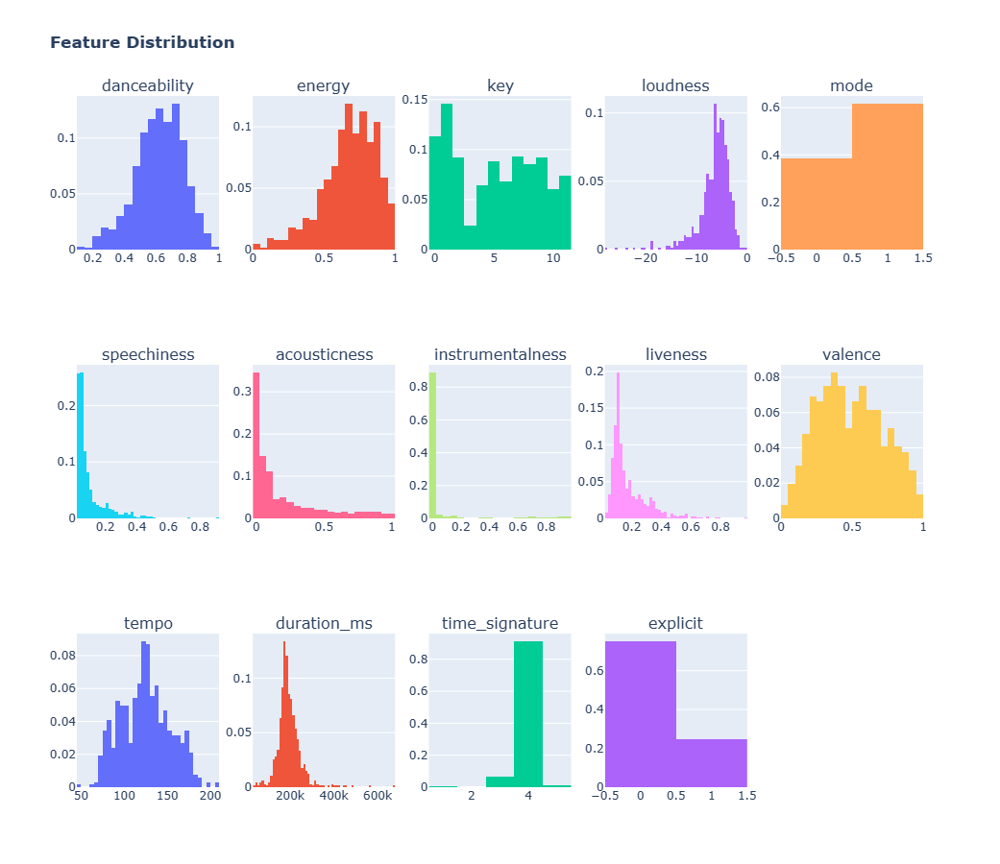

In [20]:
fig=make_subplots(rows=3,cols=5,subplot_titles=df_no_in.drop(columns='id').columns)
fig.add_trace(go.Histogram(x=df_no_in['danceability'],name='danceability',histnorm="probability"),row=1,col=1)
fig.add_trace(go.Histogram(x=df_no_in['energy'],name='energy',histnorm="probability"),row=1,col=2)
fig.add_trace(go.Histogram(x=df_no_in['key'],name='key',histnorm="probability"),row=1,col=3)
fig.add_trace(go.Histogram(x=df_no_in['loudness'],name='loudness',histnorm="probability"),row=1,col=4)
fig.add_trace(go.Histogram(x=df_no_in['mode'],name='mode',histnorm="probability"),row=1,col=5)
fig.add_trace(go.Histogram(x=df_no_in['speechiness'],name='speechiness',histnorm="probability"),row=2,col=1)
fig.add_trace(go.Histogram(x=df_no_in['acousticness'],name='acousticness',histnorm="probability"),row=2,col=2)
fig.add_trace(go.Histogram(x=df_no_in['instrumentalness'],name='instrumentalness',histnorm="probability"),row=2,col=3)
fig.add_trace(go.Histogram(x=df_no_in['liveness'],name='liveness',histnorm="probability"),row=2,col=4)
fig.add_trace(go.Histogram(x=df_no_in['valence'],name='valence',histnorm="probability"),row=2,col=5)
fig.add_trace(go.Histogram(x=df_no_in['tempo'],name='tempo',histnorm="probability"),row=3,col=1)
fig.add_trace(go.Histogram(x=df_no_in['duration_ms'],name='duration_ms',histnorm="probability"),row=3,col=2)
fig.add_trace(go.Histogram(x=df_no_in['time_signature'],name='time_signature',histnorm="probability"),row=3,col=3)
fig.add_trace(go.Histogram(x=df_no_in['explicit'],name='explicit',histnorm="probability"),row=3,col=4)
fig.update_layout(showlegend=False)
fig.update_layout(height=900,width=1100,title_text='<b>Feature Distribution')

In [21]:
df1 = df.copy()
df1['no_in'] = False

df2 = df.copy()
df2['no_in'] = True

frames = [df1,df2]
result = pd.concat(frames)

In [22]:
df_vn_temp=df_vn.copy()

In [23]:
df_vn_temp['quarter'] = df_vn_temp['date'].dt.quarter

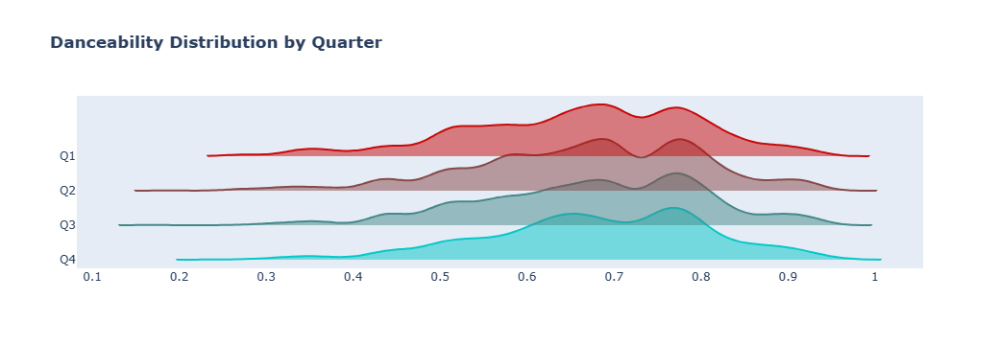

In [24]:
from plotly.colors import n_colors

colors = n_colors('rgb(5, 200, 200)', 'rgb(200, 10, 10)', 4, colortype='rgb')

fig = go.Figure()

quarter_labels = ['Q4', 'Q3', 'Q2', 'Q1']

for q, color, label in zip([4, 3, 2, 1], colors, quarter_labels):
    data = pd.merge(df_vn_temp[df_vn_temp.quarter == q], df, on='id', how='inner')['danceability']
    fig.add_trace(go.Violin(x=data, line_color=color, name=label))

fig.update_traces(orientation='h', side='positive', width=3, points=False)
fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)

# Add legend
fig.update_layout(
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1
    )
)
fig.update_layout(showlegend=False)
fig.update_layout(title_text='<b>Danceability Distribution by Quarter')
fig.show()

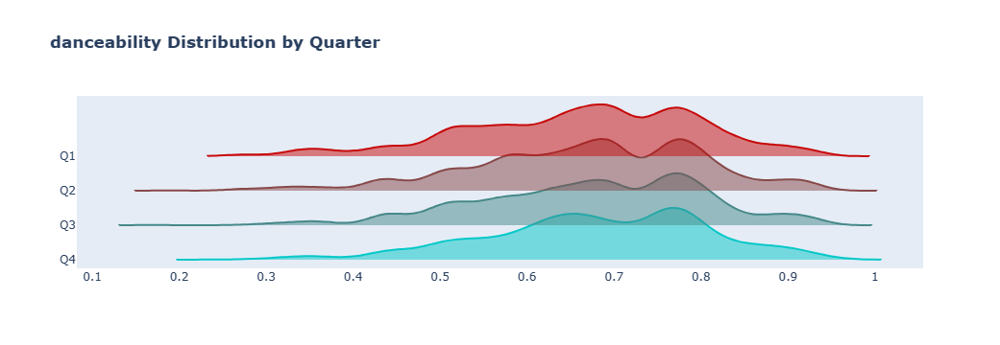

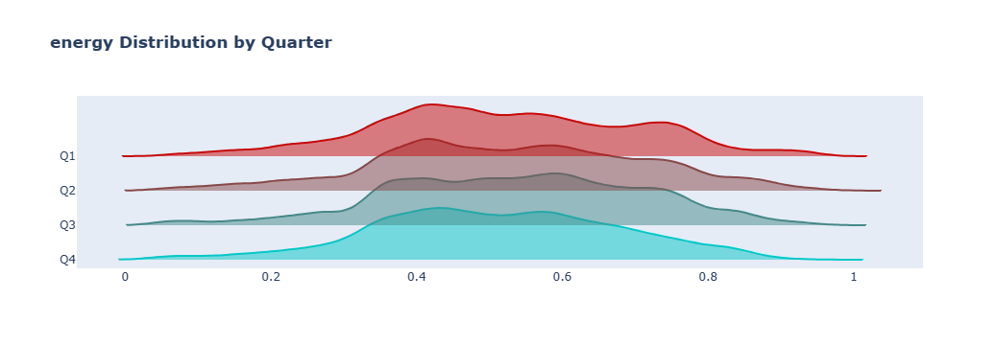

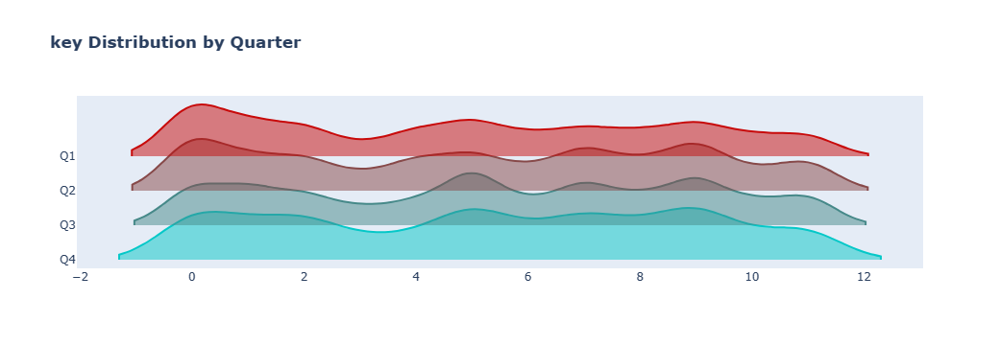

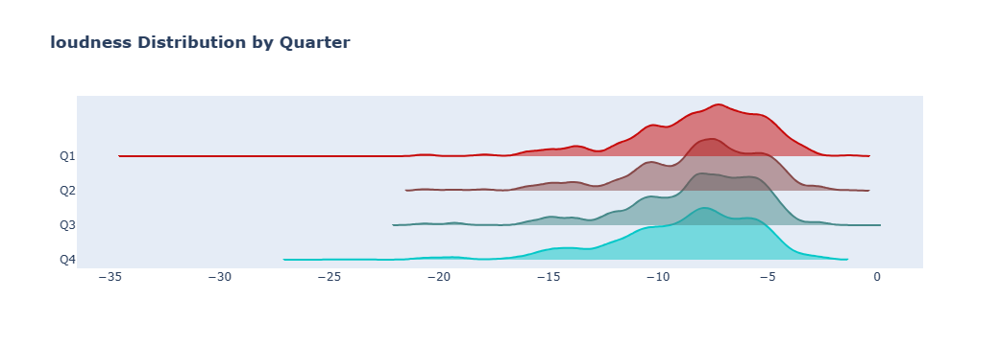

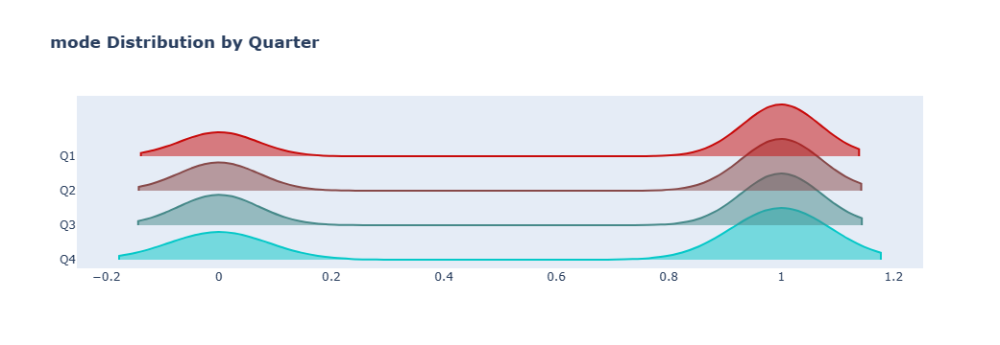

...

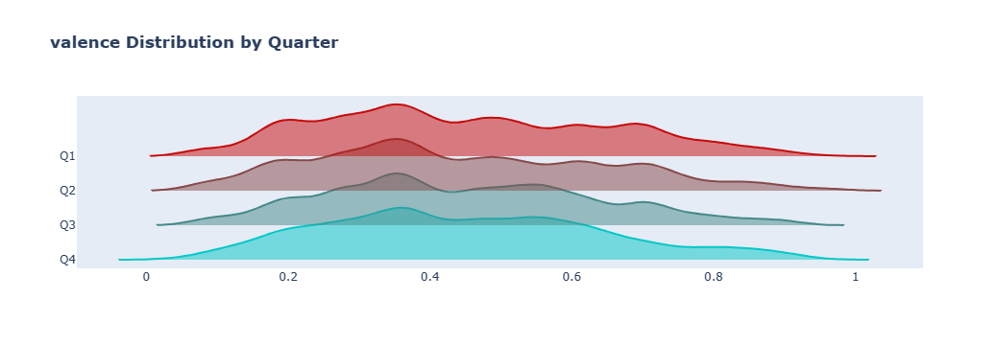

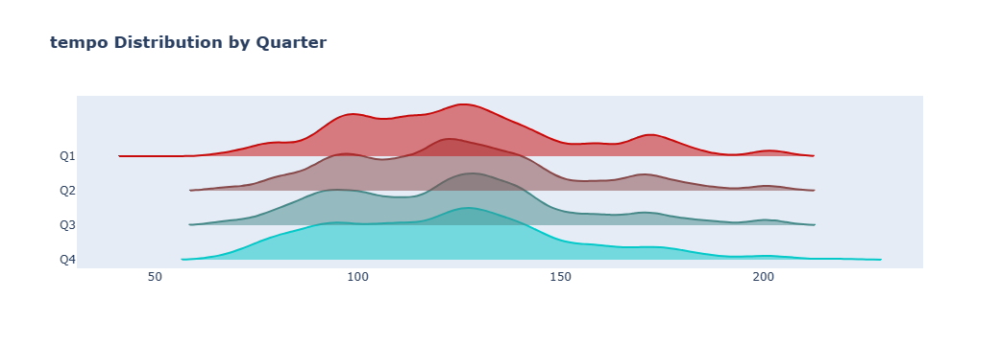

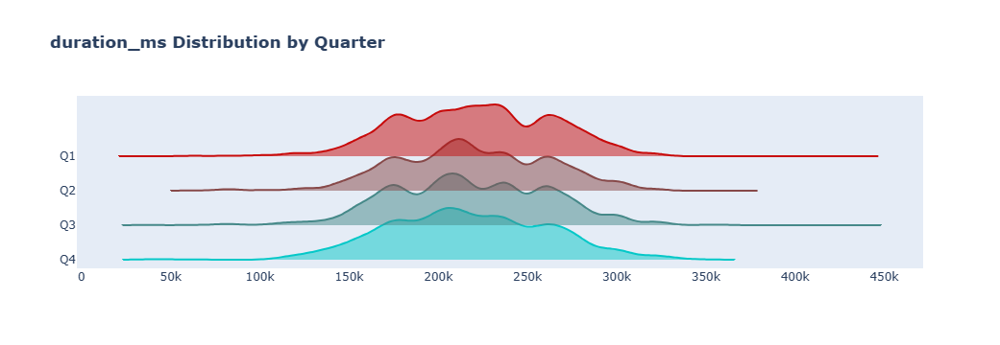

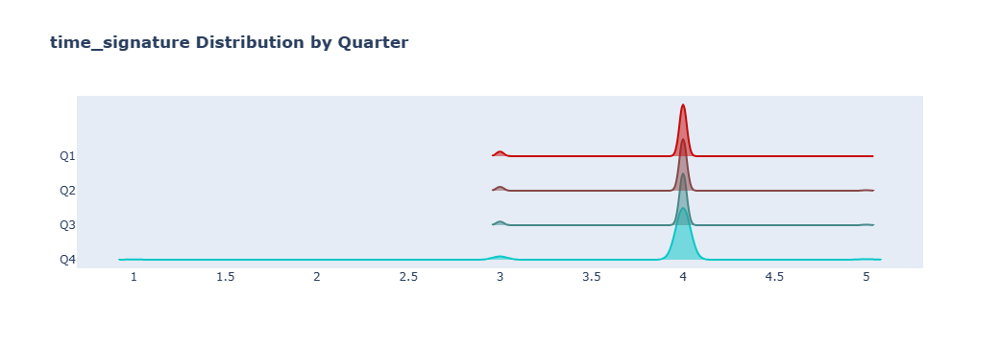

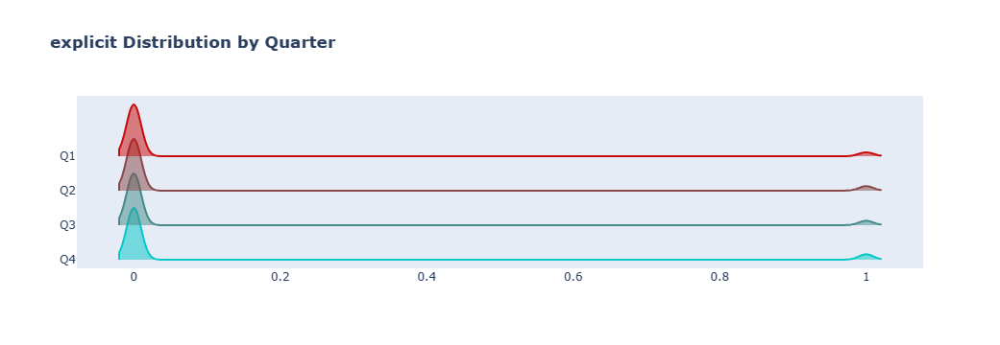

In [25]:
colors = n_colors('rgb(5, 200, 200)', 'rgb(200, 10, 10)', 4, colortype='rgb')

quarter_labels = ['Q4', 'Q3', 'Q2', 'Q1']

for feature in df.drop(columns=['id']).columns:
    fig = go.Figure()

    for q, color, label in zip([4, 3, 2, 1], colors, quarter_labels):
        data = pd.merge(df_vn_temp[df_vn_temp.quarter == q], df, on='id', how='inner')[feature]
        fig.add_trace(go.Violin(x=data, line_color=color, name=label))

    fig.update_traces(orientation='h', side='positive', width=3, points=False)
    fig.update_layout(xaxis_showgrid=False, xaxis_zeroline=False)

    # Add legend
    fig.update_layout(
        legend=dict(
            orientation="h",
            yanchor="bottom",
            y=1.02,
            xanchor="right",
            x=1
        )
    )
    fig.update_layout(showlegend=False)
    fig.update_layout(title_text=f'<b>{feature} Distribution by Quarter')
    fig.show()

### **Bài hát thật sự là hit**

In [76]:
df_vn= df_vn.drop_duplicates()
df_glob= df_glob.drop_duplicates()

<AxesSubplot:>

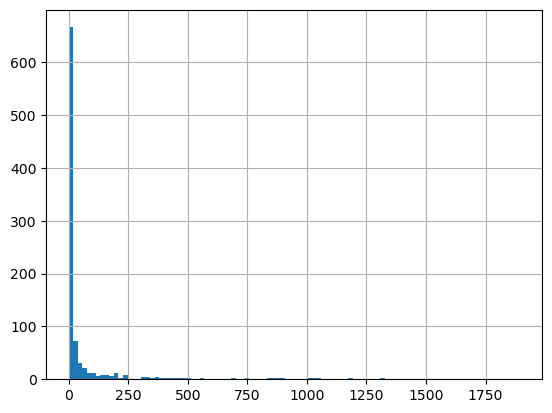

In [62]:
df_vn_temp = df_vn.copy()

df_vn_temp.sort_values(by='date', ascending=False, inplace=True)
df_vn_temp.drop_duplicates(subset='id', keep='first', inplace=True)
df_vn_temp.reset_index(drop=True, inplace=True)

df_vn_temp.streak.hist(bins=100)

In [95]:
df_vn_temp[df_vn_temp.streak>=500]

,date,position,id,track,artist,peak,prev,streak,streams
4,2023-10-30,71,769IjpjHNrN36SPvj2ZBKu,Nghe Như Tình Yêu,HIEUTHUHAI,41,75,744,26582
7,2023-10-30,68,1J3SmWwlYAG68LGKr86MVH,Chúng Ta Của Hiện Tại,Sơn Tùng M-TP,1,67,1045,27232
10,2023-10-30,65,5uyNAX6MazVAjBjVeOsTvp,3 1 0 7 (feat. Duongg & Nâu),"W/N, Duongg, Nâu",11,62,1179,27666
17,2023-10-30,58,4AgFXIVT7hVhBZ5DEOaLu3,tiny love,Thịnh Suy,2,57,694,28855
18,2023-10-30,57,5BTzf3doGTigDIYUFtbkI9,Sinh Ra Đã Là Thứ Đối Lập Nhau (feat. Badbies),"Emcee L (Da LAB), Da LAB, Badbies",5,56,1036,29869
22,2023-10-30,53,4qJSUFwZFouto5VZUlln75,Thích Quá Rùi Nà,"tlinh, Trung Trần",30,47,1138,31839
24,2023-10-30,74,2WOpp4vm16unl0N3i3BNNv,Tình Đắng Như Ly Cà Phê,"NÂN, Ngơ",14,64,1319,25843
25,2023-10-30,75,6iXGivPFpsqKmrINhIbPvx,Buồn Thì Cứ Khóc Đi,Lynk Lee,8,83,1326,25664
36,2023-10-30,90,4Iz5EWPCAT8jYNk4IpLoll,Dù Cho Mai Về Sau,buitruonglinh,9,80,956,22905
41,2023-10-30,85,1MiJk3dXC5jzhvLFP0dUM7,Thức Giấc,Da LAB,1,70,839,24033


<AxesSubplot:>

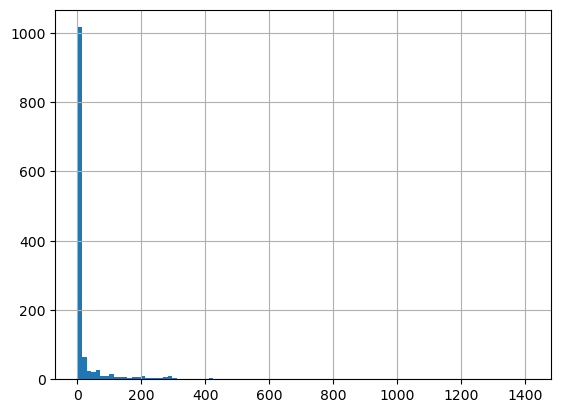

In [64]:
df_glob_temp = df_glob.copy()

df_glob_temp.sort_values(by='date', ascending=False, inplace=True)
df_glob_temp.drop_duplicates(subset='id', keep='first', inplace=True)
df_glob_temp.reset_index(drop=True, inplace=True)

df_glob_temp.streak.hist(bins=100)

In [65]:
df_glob_temp[df_glob_temp.streak>=1000]

,date,position,id,track,artist,peak,prev,streak,streams
2,2023-10-9,75,0VjIjW4GlUZAMYd2vXMi3b,Blinding Lights,The Weeknd,1,82,1411,1643184
82,2023-10-9,45,2QjOHCTQ1Jl3zawyYOpxh6,Sweater Weather,The Neighbourhood,19,50,1122,2012089
192,2023-10-9,137,3USxtqRwSYz57Ewm6wWRMp,Heat Waves,Glass Animals,1,137,1018,1300578


### **Bài hát sở hữu lượt stream nhiều nhất trong năm nay**

In [66]:
df_vn[df_vn.streams==df_vn.streams.max()]

,date,position,id,track,artist,peak,prev,streak,streams
40392,2023-07-21,1,7x9aauaA9cu6tyfpHnqDLo,Seven (feat. Latto) (Explicit Ver.),"Jung Kook, Latto",1,1,8,1121657


In [67]:
df_glob[df_glob.streams==df_glob.streams.max()]

,date,position,id,track,artist,peak,prev,streak,streams
3980,2023-01-20,1,0yLdNVWF3Srea0uzk55zFn,Flowers,Miley Cyrus,1,1,8,18424325


### **Nghệ sĩ có nhiều bài hát lọt vào bảng xếp hạng nhất**

In [71]:
top_songs = df_vn_temp.groupby(['artist'])['track'].count()
top_songs = top_songs.sort_values(ascending=False)

top_songs[:10]

artist
Taylor Swift     38
Sơn Tùng M-TP    17
BTS              15
Obito            15
Agust D          13
HIEUTHUHAI       13
NewJeans         13
RPT MCK          12
Jimin            11
tlinh            11
Name: track, dtype: int64

In [72]:
top_songs = df_glob_temp.groupby(['artist'])['track'].count()
top_songs = top_songs.sort_values(ascending=False)

top_songs[:10]

artist
Taylor Swift      68
Morgan Wallen     23
Bad Bunny         21
Olivia Rodrigo    18
Lil Uzi Vert      17
Zach Bryan        16
Post Malone       16
Miley Cyrus       15
Drake             14
Ed Sheeran        13
Name: track, dtype: int64

### **Tổng lượt stream theo thời gian**

In [73]:
df_vn.groupby('date')['streams'].sum()

date
2023-01-01    3134877
2023-01-02    3476018
2023-01-03    3312132
2023-01-04    3320946
2023-01-05    3405505
               ...   
2023-10-26    6717107
2023-10-27    6864369
2023-10-28    6691910
2023-10-29    7150332
2023-10-30    6889646
Name: streams, Length: 303, dtype: int64

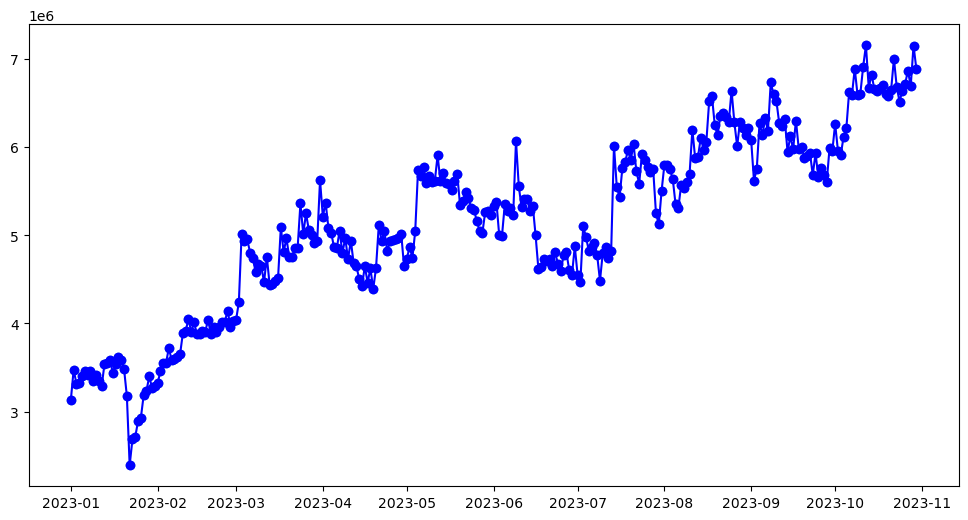

In [82]:
import matplotlib.pyplot as plt

grouped_data = df_vn.groupby('date')['streams'].sum()

plt.figure(figsize=(12, 6))
plt.scatter(grouped_data.index, grouped_data.values, alpha=0.7)
plt.plot(grouped_data.index, grouped_data.values, linestyle='-', marker='o', color='b')

plt.show()


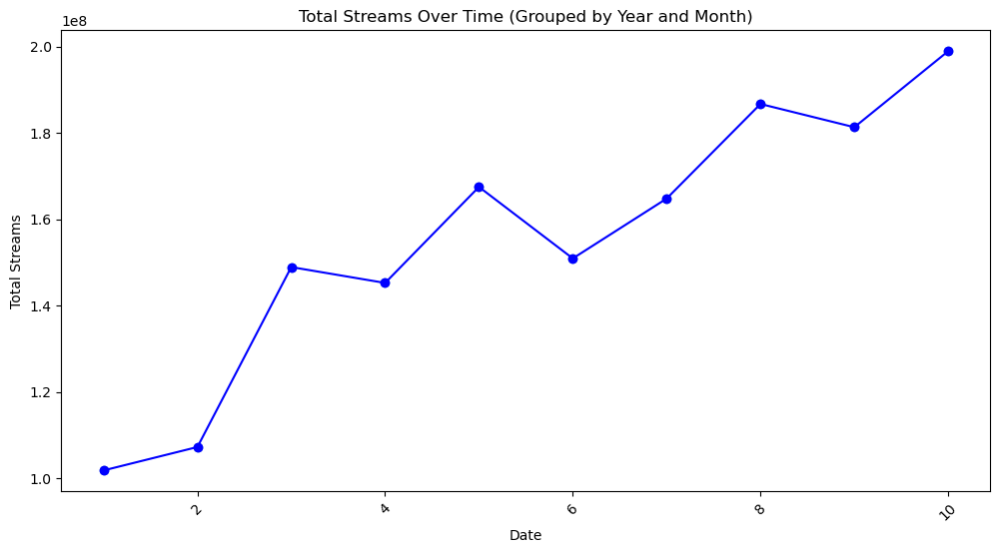

In [85]:
df_vn['Year'] = df_vn['date'].dt.year
df_vn['Month'] = df_vn['date'].dt.month

grouped_data = df_vn.groupby(['Month'])['streams'].sum()

plt.figure(figsize=(12, 6))
plt.scatter(grouped_data.index, grouped_data.values, alpha=0.7)
plt.plot(grouped_data.index, grouped_data.values, linestyle='-', marker='o', color='b')
plt.xlabel('Date')
plt.ylabel('Total Streams')
plt.title('Total Streams Over Time (Grouped by Year and Month)')
plt.xticks(rotation=45) 

plt.show()

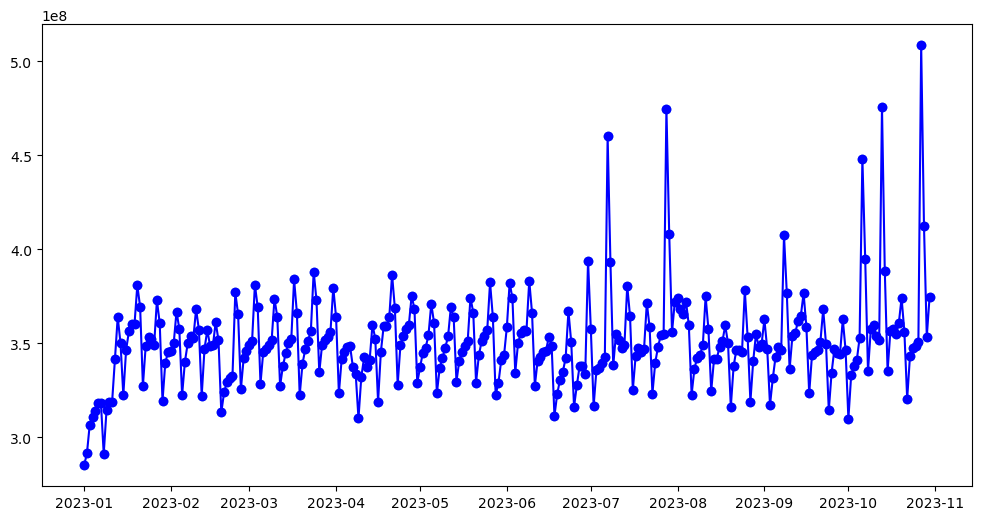

In [80]:
import matplotlib.pyplot as plt

grouped_data = df_glob.groupby('date')['streams'].sum()

plt.figure(figsize=(12, 6))
plt.scatter(grouped_data.index, grouped_data.values, alpha=0.7)
plt.plot(grouped_data.index, grouped_data.values, linestyle='-', marker='o', color='b')

plt.show()


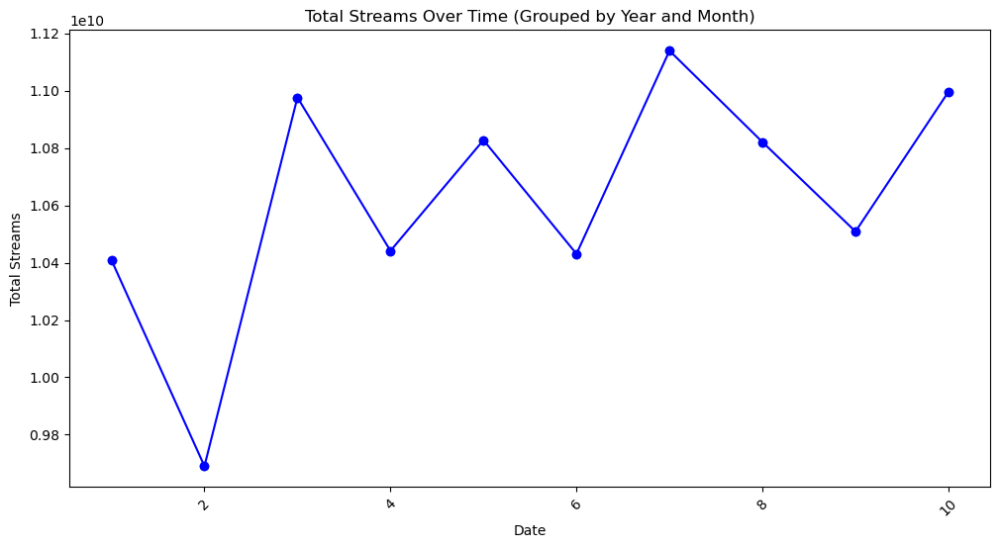

In [86]:
df_glob['Year'] = df_glob['date'].dt.year
df_glob['Month'] = df_glob['date'].dt.month

grouped_data = df_glob.groupby(['Month'])['streams'].sum()

plt.figure(figsize=(12, 6))
plt.scatter(grouped_data.index, grouped_data.values, alpha=0.7)
plt.plot(grouped_data.index, grouped_data.values, linestyle='-', marker='o', color='b')
plt.xlabel('Date')
plt.ylabel('Total Streams')
plt.title('Total Streams Over Time (Grouped by Year and Month)')
plt.xticks(rotation=45) 

plt.show()